<a href="https://colab.research.google.com/github/navinbhagat322/Steel-Strength-prediction-DC-Project/blob/main/prediction_of_mechanical_properties_of_steels.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
plt.style.use("seaborn-whitegrid")
import pandas_profiling as pp

import seaborn as sns




# 1. Load and Check Data

In [ ]:
df =  pd.read_excel("/input/steel.xlsx")

In [ ]:
df.head()

,Sl. No.,NT,THT,THt,THQCr,CT,Ct,DT,Dt,QmT,...,S,Ni,Cr,Cu,Mo,RedRatio,dA,dB,dC,Fatigue
0,1,885,30,0,0,30,0.0,30.0,0.0,30,...,0.022,0.01,0.02,0.01,0.0,825,0.07,0.02,0.04,232
1,2,885,30,0,0,30,0.0,30.0,0.0,30,...,0.017,0.08,0.12,0.08,0.0,610,0.11,0.00,0.04,235
2,3,885,30,0,0,30,0.0,30.0,0.0,30,...,0.015,0.02,0.03,0.01,0.0,1270,0.07,0.02,0.00,235
3,4,885,30,0,0,30,0.0,30.0,0.0,30,...,0.024,0.01,0.02,0.01,0.0,1740,0.06,0.00,0.00,241
4,5,885,30,0,0,30,0.0,30.0,0.0,30,...,0.022,0.01,0.02,0.02,0.0,825,0.04,0.02,0.00,225


In [ ]:
df.shape

(437, 27)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 437 entries, 0 to 436
Data columns (total 27 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Sl. No.   437 non-null    int64  
 1   NT        437 non-null    int64  
 2   THT       437 non-null    int64  
 3   THt       437 non-null    int64  
 4   THQCr     437 non-null    int64  
 5   CT        437 non-null    int64  
 6   Ct        437 non-null    float64
 7   DT        437 non-null    float64
 8   Dt        437 non-null    float64
 9   QmT       437 non-null    int64  
 10  TT        437 non-null    int64  
 11  Tt        437 non-null    int64  
 12  TCr       437 non-null    float64
 13  C         437 non-null    float64
 14  Si        437 non-null    float64
 15  Mn        437 non-null    float64
 16  P         437 non-null    float64
 17  S         437 non-null    float64
 18  Ni        437 non-null    float64
 19  Cr        437 non-null    float64
 20  Cu        437 non-null    float6

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Sl. No.,437.0,219.000000,126.295289,1.000,110.000,219.000,328.000,437.000
NT,437.0,872.299771,26.212073,825.000,865.000,870.000,870.000,930.000
THT,437.0,737.643021,280.036541,30.000,845.000,845.000,855.000,865.000
THt,437.0,25.949657,10.263824,0.000,30.000,30.000,30.000,30.000
THQCr,437.0,10.654462,7.841437,0.000,8.000,8.000,8.000,24.000
CT,437.0,128.855835,281.743539,30.000,30.000,30.000,30.000,930.000
Ct,437.0,40.502059,126.924697,0.000,0.000,0.000,0.000,540.000
DT,437.0,123.699844,267.128933,30.000,30.000,30.000,30.000,903.333
Dt,437.0,4.843936,15.700076,0.000,0.000,0.000,0.000,70.200
QmT,437.0,35.491991,19.419277,30.000,30.000,30.000,30.000,140.000


## Variable Description

* C % - Carbon
* Si % - Silicon
* Mn % - Manganese
* P % - Phosphorus
* S % - Sulphur
* Ni % - Nickel
* Cr % - Chromium
* Cu % - Copper
* Mo % - Molybdenum
* NT - Normalizing Temperature
* THT - Through Hardening Temperature
* THt - Through Hardening Time
* THQCr - Cooling Rate for Through Hardening
* CT - Carburization Temperature
* Ct - Carburization Time
* DT - Diffusion Temperature
* Dt - Diffusion time
* QmT - Quenching Media Temperature (for Carburization)
* TT - Tempering Temperature
* Tt - Tempering Time
* TCr - Cooling Rate for Tempering
* RedRatio - Reduction Ratio (Ingot to Bar)
* dA  - Area Proportion of Inclusions Deformed by Plastic Work
* dB  -Area Proportion of Inclusions Occurring in Discontinuous Array
* dC  -Area Proportion of Isolated Inclusions
* Fatigue  - Rotating Bending Fatigue Strength (107 Cycles)




# 2.Visualization

In [ ]:
profile_report = pp.ProfileReport(df)

In [ ]:
profile_report

In [ ]:
df_1 = df[["C", "Si", "Mn", "P", "S", "Ni", "Cu", "Cr", "Mo"]]
df_2 = df[['NT', 'THT', 'THt', 'THQCr', 'CT', 'Ct', 'DT', 'Dt', 'QmT',
       'TT', 'Tt', 'TCr']]

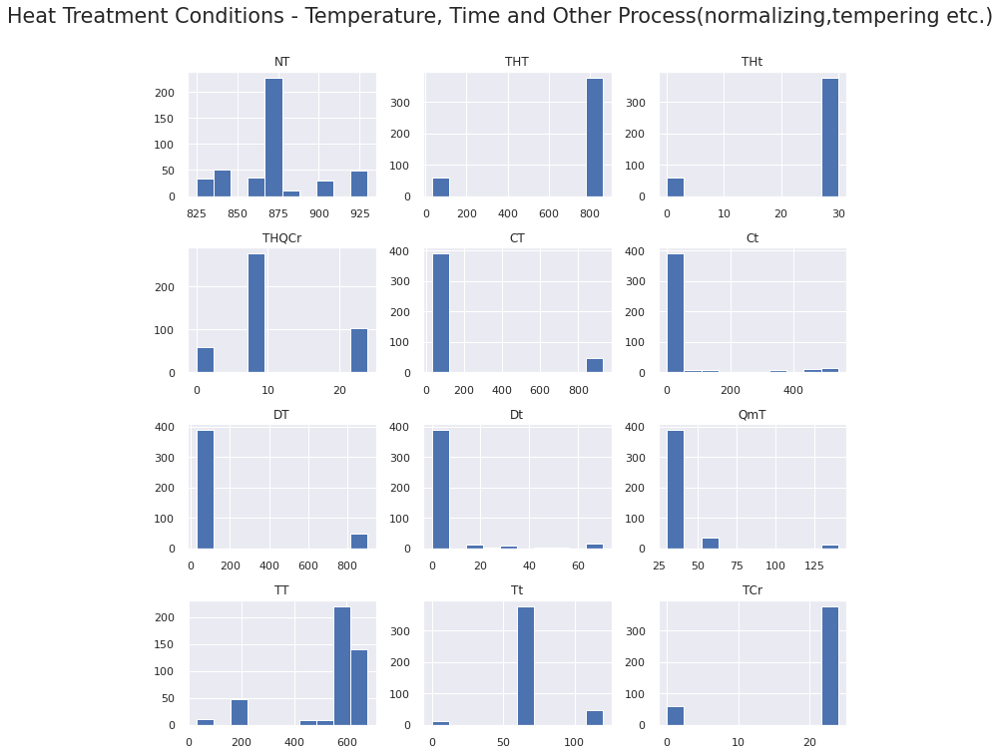

In [ ]:
sns.set(font_scale = 1)
df_2.hist(figsize=(10, 10));
plt.suptitle("Heat Treatment Conditions - Temperature, Time and Other Process(normalizing,tempering etc.)",
             x=0.5, y=1.05, ha='center', fontsize='xx-large');
plt.tight_layout();



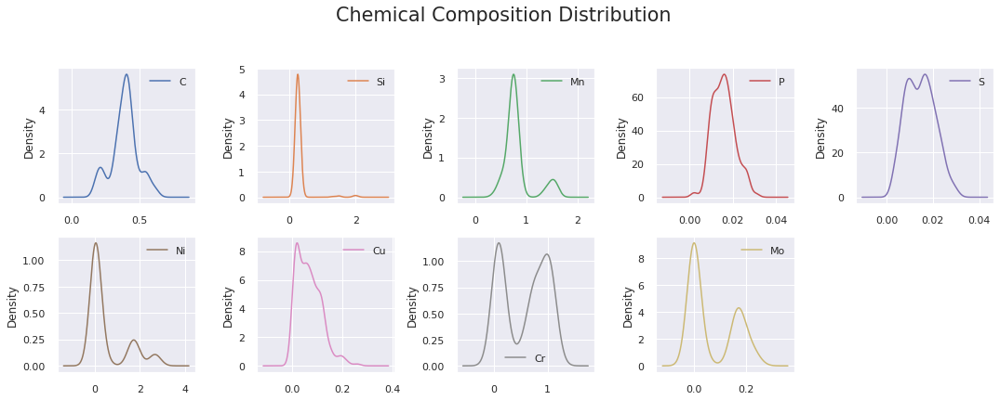

In [ ]:
df_1.plot(kind="density", layout=(6,5),subplots=True,sharex=False, sharey=False, figsize=(15,15));
plt.suptitle("Chemical Composition Distribution",
             x=0.5, y=1.05, ha='center', fontsize='xx-large');
plt.tight_layout()

* The database comprises carbon and low-alloy steels, carburizing steels and spring steels. You can see Cr-Mo steels and Cr-Mo-Ni Steels. You can see  below alloy composition(weight (%)) in Cr-Mo Steels.

<table class="wikitable">
<caption>Alloy composition by weight (%)<sup id="cite_ref-Catalog_2-0" class="reference"><a href="#cite_note-Catalog-2">[2]</a></sup>
</caption>
<tbody><tr>
<th><a href="/wiki/SAE_steel_grades" title="SAE steel grades">SAE grade</a>
</th>
<th><a href="/wiki/Chromium" title="Chromium">Cr</a>
</th>
<th><a href="/wiki/Molybdenum" title="Molybdenum">Mo</a>
</th>
<th><a href="/wiki/Carbon" title="Carbon">C</a><sup id="cite_ref-3" class="reference"><a href="#cite_note-3">[a]</a></sup>
</th>
<th><a href="/wiki/Manganese" title="Manganese">Mn</a>
</th>
<th><a href="/wiki/Phosphorus" title="Phosphorus">P</a>, <abbr title="maximum">max.</abbr>
</th>
<th><a href="/wiki/Sulphur" class="mw-redirect" title="Sulphur">S</a>, <abbr title="maximum">max.</abbr>
</th>
<th><a href="/wiki/Silicon" title="Silicon">Si</a>
</th></tr>
<tr>
<td>4118</td>
<td>0.40–0.60</td>
<td>0.08–0.15</td>
<td>0.18–0.23</td>
<td>0.70–0.90</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4120</td>
<td>0.40–0.60</td>
<td>0.13–0.20</td>
<td>0.18–0.23</td>
<td>0.90–1.20</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4121</td>
<td>0.45–0.65</td>
<td>0.20–0.30</td>
<td>0.18–0.23</td>
<td>0.75–1.00</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4130</td>
<td>0.80–1.10</td>
<td>0.15–0.25</td>
<td>0.28–0.33</td>
<td>0.40–0.60</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4135</td>
<td>0.80–1.10</td>
<td>0.15–0.25</td>
<td>0.33–0.38</td>
<td>0.70–0.90</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4137</td>
<td>0.80–1.10</td>
<td>0.15–0.25</td>
<td>0.35–0.40</td>
<td>0.70–0.90</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4140</td>
<td>0.80–1.10</td>
<td>0.15–0.25</td>
<td>0.38–0.43</td>
<td>0.75–1.00</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4142</td>
<td>0.80–1.10</td>
<td>0.15–0.25</td>
<td>0.40–0.45</td>
<td>0.75–1.00</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4145</td>
<td>0.80–1.10</td>
<td>0.15–0.25</td>
<td>0.43–0.48</td>
<td>0.75–1.00</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4147</td>
<td>0.80–1.10</td>
<td>0.15–0.25</td>
<td>0.45–0.50</td>
<td>0.75–1.00</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4150</td>
<td>0.80–1.10</td>
<td>0.15–0.25</td>
<td>0.48–0.53</td>
<td>0.75–1.00</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td>4161</td>
<td>0.70–0.90</td>
<td>0.25–0.35</td>
<td>0.56–0.64</td>
<td>0.75–1.00</td>
<td>0.035</td>
<td>0.040</td>
<td>0.15–0.35
</td></tr>
<tr>
<td colspan="8"><div class="reflist" style="list-style-type: lower-alpha;">
<div class="mw-references-wrap"><ol class="references">
<li id="cite_note-3"><span class="mw-cite-backlink"><b><a href="#cite_ref-3" aria-label="Jump up" title="Jump up">^</a></b></span> <span class="reference-text">The carbon composition of the alloy is denoted by the last two digits of the SAE specification number, in hundredths of a percent.</span>
</li>
</ol></div></div>
</td></tr></tbody></table>

# 3. Modelling

* Linear Regression
* KNN
* GBM
* LightGBM
* CatBoost

CrossValidation was applied to all models and best parameters were determined with model tuning.

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
df.drop(columns=['Sl. No.'], inplace = True)
X = df.drop(["Fatigue"], axis = 1)
y = df["Fatigue"]

## 3.1. Linear Regression

In [ ]:
from sklearn.linear_model import LinearRegression
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state= 42)
lm = LinearRegression()
lr_model = lm.fit(X_train, y_train)

In [ ]:
#R^2 Score with Cross Validation

cross_val_score1=cross_val_score(lr_model, X_train, y_train, cv=10, scoring='r2').mean() #verified score value for train model
print('Verified R2 value for Training model: ' + str(cross_val_score1))

cross_val_score2=cross_val_score(lr_model, X_test, y_test, cv=10, scoring='r2').mean() #verified score value for test model
print('Verified R2 value for Testing Model: ' + str(cross_val_score2))

Verified R2 value for Training model: 0.9571710993442283
Verified R2 value for Testing Model: 0.9340089728997946


In [ ]:
#Rmse Score Value with Cross Validation


train_crs_val = np.sqrt(-cross_val_score(lr_model,
                X_train,
                y_train,
                cv = 10,
                scoring = "neg_mean_squared_error")).mean()

test_crs_val = np.sqrt(-cross_val_score(lr_model,
                X_test,
                y_test,
                cv = 10,
                scoring = "neg_mean_squared_error")).mean()

print("train cross val rmse:{}\ntest cross val rmse:{}".format(train_crs_val,test_crs_val))


train cross val rmse:34.816104174203005
test cross val rmse:39.06567484385279


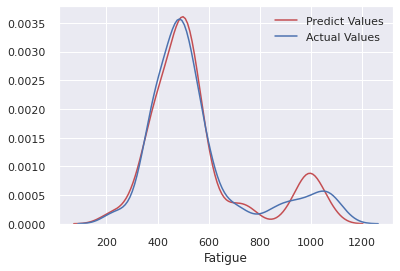

In [ ]:
ax1 = sns.distplot(lr_model.predict(X_test), hist=False, color="r", label="Predict Values")
sns.distplot(y_test, hist=False, color="b", label="Actual Values" , ax=ax1);

In [ ]:
d = {'R^2 Score ': [0.93], 'Rmse Score': [0.39]}
lr_data = pd.DataFrame(data=d)
lr_data

,R^2 Score,Rmse Score
0,0.93,0.39


## 3.2. KNN

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
knn_model = KNeighborsRegressor().fit(X_train, y_train)
print("R^2 values:{}".format(knn_model.score(X_test, y_test)))
y_pred = knn_model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("rmse: {}".format(rmse))


R^2 values:0.9048832092283499
rmse: 62.710148518981576


In [ ]:
# Model Tuning

k = {'n_neighbors': np.arange(1,30,1)}

knn_model = KNeighborsRegressor()

cv_model = GridSearchCV(knn_model, k, cv = 10)

cv_model.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=KNeighborsRegressor(),
             param_grid={'n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29])})

In [ ]:
cv_model.best_params_["n_neighbors"]

1

In [ ]:
knn_model_tuned = KNeighborsRegressor(n_neighbors = cv_model.best_params_["n_neighbors"])
knn_model_tuned.fit(X_train, y_train)

KNeighborsRegressor(n_neighbors=1)

In [ ]:
print("R^2 values:{}".format(knn_model_tuned.score(X_test, y_test)))
y_pred = knn_model_tuned.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("rmse: {}".format(rmse))

R^2 values:0.9195948039771817
rmse: 57.656900556812644


* After model tuning, R^2 score is increase, rmse score is decrease.

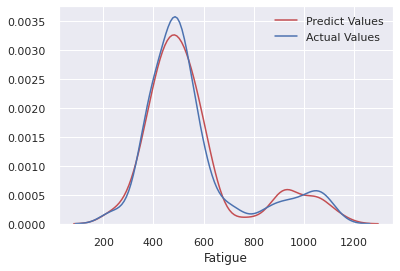

In [ ]:
ax1 = sns.distplot(knn_model_tuned.predict(X_test), hist=False, color="r", label="Predict Values")
sns.distplot(y_test, hist=False, color="b", label="Actual Values" , ax=ax1);

In [ ]:
d = {'R^2 Score ': [0.91], 'Rmse Score': [0.57]}
knn_data = pd.DataFrame(data=d)
knn_data

,R^2 Score,Rmse Score
0,0.91,0.57


## 3.3. GBM

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor
gbm_model = GradientBoostingRegressor()
gbm_model.fit(X_train, y_train)
y_pred = gbm_model.predict(X_test)

print("R^2 values:{}".format(gbm_model.score(X_test, y_test)))
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("rmse: {}".format(rmse))

R^2 values:0.9894891835207899
rmse: 20.84622695051267


In [ ]:
#model tuning

gbm_params = {
    'learning_rate': [0.001, 0.01, 0.1, 0.2],
    'max_depth': [3, 5, 8,50,100],
    'n_estimators': [200, 500, 1000, 2000],
    'subsample': [1,0.5,0.75],
}

gbm = GradientBoostingRegressor()
gbm_cv_model = GridSearchCV(gbm, gbm_params, cv = 10, n_jobs = -1, verbose = 2)
gbm_cv_model.fit(X_train, y_train)

Fitting 10 folds for each of 240 candidates, totalling 2400 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 154 tasks      | elapsed:   42.7s
[Parallel(n_jobs=-1)]: Done 357 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-1)]: Done 640 tasks      | elapsed:  6.3min
[Parallel(n_jobs=-1)]: Done 1005 tasks      | elapsed:  9.3min
[Parallel(n_jobs=-1)]: Done 1450 tasks      | elapsed: 14.7min
[Parallel(n_jobs=-1)]: Done 1977 tasks      | elapsed: 20.8min
[Parallel(n_jobs=-1)]: Done 2400 out of 2400 | elapsed: 26.5min finished


GridSearchCV(cv=10, estimator=GradientBoostingRegressor(), n_jobs=-1,
             param_grid={'learning_rate': [0.001, 0.01, 0.1, 0.2],
                         'max_depth': [3, 5, 8, 50, 100],
                         'n_estimators': [200, 500, 1000, 2000],
                         'subsample': [1, 0.5, 0.75]},
             verbose=2)

In [ ]:
gbm_cv_model.best_params_

{'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 1000, 'subsample': 0.5}

In [ ]:
gbm_tuned = GradientBoostingRegressor(learning_rate = 0.2,
                                      max_depth = 3,
                                      n_estimators = 200,
                                      subsample = 0.75)

In [ ]:
gbm_tuned = gbm_tuned.fit(X_train,y_train)

y_pred = gbm_tuned.predict(X_test)

print("R^2 values:{}".format(gbm_tuned.score(X_test, y_test)))
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("rmse: {}".format(rmse))

R^2 values:0.9861625713895312
rmse: 23.918664744391045


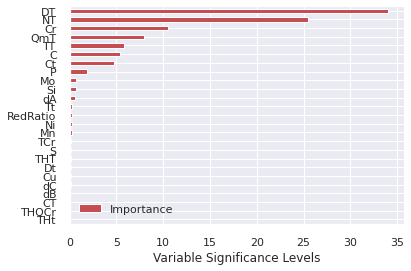

In [ ]:
Importance = pd.DataFrame({"Importance": gbm_tuned.feature_importances_*100},
                         index = X_train.columns)

Importance.sort_values(by = "Importance",
                       axis = 0,
                       ascending = True).plot(kind ="barh", color = "r");

plt.xlabel("Variable Significance Levels");

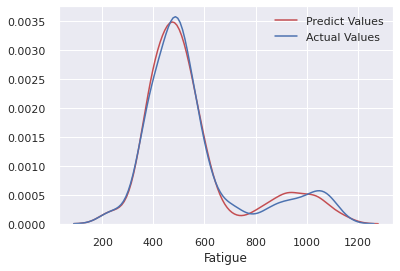

In [ ]:
ax1 = sns.distplot(gbm_tuned.predict(X_test), hist=False, color="r", label="Predict Values")
sns.distplot(y_test, hist=False, color="b", label="Actual Values" , ax=ax1);

In [ ]:
d = {'R^2 Score ': [0.98], 'Rmse Score': [0.23]}
gbm_data = pd.DataFrame(data=d)
gbm_data

,R^2 Score,Rmse Score
0,0.98,0.23


## 3.4.Light GBM

In [ ]:
from lightgbm import LGBMRegressor
lgbm = LGBMRegressor()
lgbm_model = lgbm.fit(X_train, y_train)

y_pred = lgbm_model.predict(X_test,
                            num_iteration = lgbm_model.best_iteration_)

print("R^2 values:{}".format(lgbm_model.score(X_test, y_test)))
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("rmse: {}".format(rmse))

R^2 values:0.9866324504075951
rmse: 23.509053099397544


In [ ]:
lgbm_grid = {
    'colsample_bytree': [0.4, 0.5,0.6,0.9,1],
    'learning_rate': [0.01, 0.1, 0.5,1],
    'n_estimators': [20, 40, 100, 200, 500,1000],
    'max_depth': [1,2,3,4,5,6,7,8] }

lgbm = LGBMRegressor()
lgbm_cv_model = GridSearchCV(lgbm, lgbm_grid, cv=10, n_jobs = -1, verbose = 2)
lgbm_cv_model.fit(X_train, y_train)

Fitting 10 folds for each of 960 candidates, totalling 9600 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done 128 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 628 tasks      | elapsed:   15.4s
[Parallel(n_jobs=-1)]: Done 1440 tasks      | elapsed:   38.5s
[Parallel(n_jobs=-1)]: Done 2572 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 4032 tasks      | elapsed:  1.9min
[Parallel(n_jobs=-1)]: Done 5812 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done 7920 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done 9600 out of 9600 | elapsed:  4.9min finished


GridSearchCV(cv=10, estimator=LGBMRegressor(), n_jobs=-1,
             param_grid={'colsample_bytree': [0.4, 0.5, 0.6, 0.9, 1],
                         'learning_rate': [0.01, 0.1, 0.5, 1],
                         'max_depth': [1, 2, 3, 4, 5, 6, 7, 8],
                         'n_estimators': [20, 40, 100, 200, 500, 1000]},
             verbose=2)

In [ ]:
lgbm_cv_model.best_params_

{'colsample_bytree': 0.5,
 'learning_rate': 0.1,
 'max_depth': 3,
 'n_estimators': 1000}

In [ ]:
lgbm_tuned = LGBMRegressor(learning_rate = 0.1,
                           max_depth = 3,
                           n_estimators = 1000,
                          colsample_bytree = 0.5)

In [ ]:
lgbm_tuned = lgbm_tuned.fit(X_train,y_train)
y_pred = lgbm_tuned.predict(X_test)
print("R^2 values:{}".format(lgbm_tuned.score(X_test, y_test)))
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("rmse: {}".format(rmse))

R^2 values:0.9904179985446365
rmse: 19.9038619657335


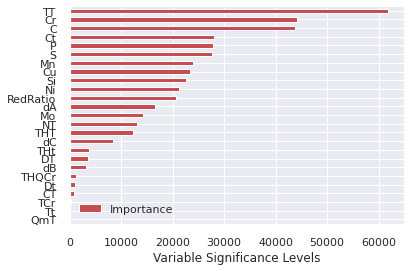

In [ ]:
Importance = pd.DataFrame({"Importance": lgbm_tuned.feature_importances_*100},
                         index = X_train.columns)

Importance.sort_values(by = "Importance",
                       axis = 0,
                       ascending = True).plot(kind ="barh", color = "r");

plt.xlabel("Variable Significance Levels");

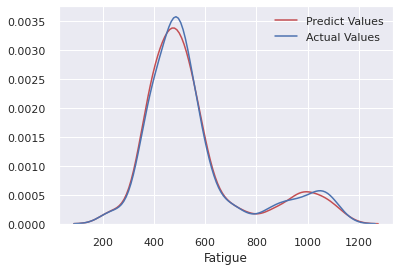

In [ ]:
ax1 = sns.distplot(lgbm_tuned.predict(X_test), hist=False, color="r", label="Predict Values")
sns.distplot(y_test, hist=False, color="b", label="Actual Values" , ax=ax1);

In [ ]:
d = {'R^2 Score ': [0.99], 'Rmse Score': [0.18]}
lgbm_data = pd.DataFrame(data=d)
lgbm_data

,R^2 Score,Rmse Score
0,0.99,0.18


## 3.5. CatBoost

In [ ]:
from catboost import CatBoostRegressor

catb = CatBoostRegressor()
catb_model = catb.fit(X_train, y_train)
y_pred = catb_model.predict(X_test)
print("R^2 values:{}".format(catb_model.score(X_test, y_test)))
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("rmse: {}".format(rmse))

Learning rate set to 0.032361
0:	learn: 177.4478114	total: 51.8ms	remaining: 51.8s
1:	learn: 173.9610421	total: 52.9ms	remaining: 26.4s
2:	learn: 170.0285204	total: 53.8ms	remaining: 17.9s
3:	learn: 166.4331130	total: 54.7ms	remaining: 13.6s
4:	learn: 162.8833436	total: 55.4ms	remaining: 11s
5:	learn: 159.4933728	total: 55.9ms	remaining: 9.26s
6:	learn: 156.4012373	total: 56.6ms	remaining: 8.03s
7:	learn: 153.6633801	total: 57.4ms	remaining: 7.12s
8:	learn: 150.5279482	total: 58ms	remaining: 6.38s
9:	learn: 147.4885551	total: 58.5ms	remaining: 5.79s
10:	learn: 144.0743116	total: 59.5ms	remaining: 5.35s
11:	learn: 140.9940090	total: 60.4ms	remaining: 4.98s
12:	learn: 137.7202945	total: 61.4ms	remaining: 4.66s
13:	learn: 134.8764247	total: 62.1ms	remaining: 4.37s
14:	learn: 131.9199717	total: 63.3ms	remaining: 4.16s
15:	learn: 128.9014678	total: 64.6ms	remaining: 3.98s
16:	learn: 126.2689417	total: 65.5ms	remaining: 3.79s
17:	learn: 123.8289735	total: 66.5ms	remaining: 3.63s
18:	learn: 1

In [ ]:
#Model Tuning

catb_grid = {
    'iterations': [200,500,1000,2000],
    'learning_rate': [0.01, 0.03, 0.05, 0.1],
    'depth': [3,4,5,6,7,8] }

catb = CatBoostRegressor()
catb_cv_model = GridSearchCV(catb, catb_grid, cv=5, n_jobs = -1, verbose = 2)

catb_cv_model.fit(X_train, y_train)

Fitting 5 folds for each of 96 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:    8.9s
[Parallel(n_jobs=-1)]: Done 154 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done 357 tasks      | elapsed:  5.5min
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed: 10.2min finished


0:	learn: 175.2541395	total: 913us	remaining: 912ms
1:	learn: 169.8203652	total: 1.83ms	remaining: 912ms
2:	learn: 164.3307494	total: 2.48ms	remaining: 824ms
3:	learn: 158.4022795	total: 3.1ms	remaining: 772ms
4:	learn: 152.8646030	total: 3.68ms	remaining: 733ms
5:	learn: 147.6213425	total: 4.17ms	remaining: 691ms
6:	learn: 142.9034052	total: 4.77ms	remaining: 676ms
7:	learn: 138.2581849	total: 5.32ms	remaining: 660ms
8:	learn: 133.6925525	total: 6.07ms	remaining: 668ms
9:	learn: 129.6215527	total: 7.19ms	remaining: 712ms
10:	learn: 125.7119853	total: 7.88ms	remaining: 709ms
11:	learn: 122.4689340	total: 8.73ms	remaining: 719ms
12:	learn: 118.8702503	total: 9.51ms	remaining: 722ms
13:	learn: 114.9416395	total: 10.3ms	remaining: 723ms
14:	learn: 112.5584509	total: 10.9ms	remaining: 715ms
15:	learn: 109.8740909	total: 11.5ms	remaining: 710ms
16:	learn: 107.0222189	total: 12.2ms	remaining: 707ms
17:	learn: 104.1129430	total: 13ms	remaining: 707ms
18:	learn: 101.6766639	total: 13.6ms	remai

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostRegressor object at 0x7f34a06691d0>,
             n_jobs=-1,
             param_grid={'depth': [3, 4, 5, 6, 7, 8],
                         'iterations': [200, 500, 1000, 2000],
                         'learning_rate': [0.01, 0.03, 0.05, 0.1]},
             verbose=2)

In [ ]:
catb_cv_model.best_params_

{'depth': 4, 'iterations': 1000, 'learning_rate': 0.05}

In [ ]:
catb_tuned = CatBoostRegressor(iterations = 1000,
                               learning_rate = 0.05,
                               depth = 4)

In [ ]:
catb_tuned = catb_tuned.fit(X_train,y_train)
y_pred = catb_tuned.predict(X_test)
print("R^2 values:{}".format(catb_tuned.score(X_test, y_test)))
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("rmse: {}".format(rmse))

0:	learn: 175.2541395	total: 646us	remaining: 646ms
1:	learn: 169.8203652	total: 1.6ms	remaining: 797ms
2:	learn: 164.3307494	total: 2.21ms	remaining: 734ms
3:	learn: 158.4022795	total: 2.8ms	remaining: 697ms
4:	learn: 152.8646030	total: 3.33ms	remaining: 664ms
5:	learn: 147.6213425	total: 3.85ms	remaining: 638ms
6:	learn: 142.9034052	total: 4.38ms	remaining: 621ms
7:	learn: 138.2581849	total: 4.96ms	remaining: 615ms
8:	learn: 133.6925525	total: 5.65ms	remaining: 622ms
9:	learn: 129.6215527	total: 6.51ms	remaining: 645ms
10:	learn: 125.7119853	total: 7.26ms	remaining: 653ms
11:	learn: 122.4689340	total: 7.89ms	remaining: 650ms
12:	learn: 118.8702503	total: 8.43ms	remaining: 640ms
13:	learn: 114.9416395	total: 8.99ms	remaining: 633ms
14:	learn: 112.5584509	total: 9.58ms	remaining: 629ms
15:	learn: 109.8740909	total: 10.2ms	remaining: 628ms
16:	learn: 107.0222189	total: 10.8ms	remaining: 627ms
17:	learn: 104.1129430	total: 11.4ms	remaining: 625ms
18:	learn: 101.6766639	total: 12.1ms	rema

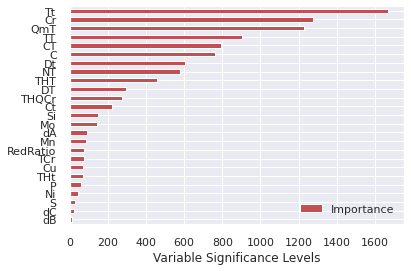

In [ ]:
Importance = pd.DataFrame({"Importance": catb_tuned.feature_importances_*100},
                         index = X_train.columns)

Importance.sort_values(by = "Importance",
                       axis = 0,
                       ascending = True).plot(kind ="barh", color = "r");

plt.xlabel("Variable Significance Levels");

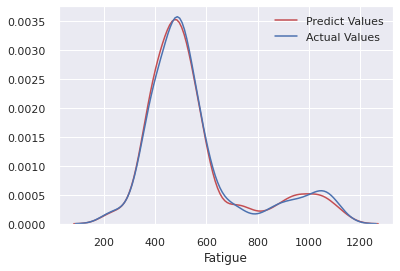

In [ ]:
ax1 = sns.distplot(catb_tuned.predict(X_test), hist=False, color="r", label="Predict Values")
sns.distplot(y_test, hist=False, color="b", label="Actual Values" , ax=ax1);

In [ ]:
d = {'R^2 Score ': [0.99], 'Rmse Score': [0.18]}
catb_data = pd.DataFrame(data=d)
catb_data

,R^2 Score,Rmse Score
0,0.99,0.18


# 4.Model Comparison

## 4.1. RMSE Value Comparison

In [ ]:
models = [

    lr_model,
    knn_model_tuned,
    gbm_tuned,
    lgbm_tuned,
    catb_tuned,


]


for model in models:
    name = model.__class__.__name__
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print("-"*28)
    print(name + ":" )
    print("Rmse: {:.4%}".format(rmse))

----------------------------
LinearRegression:
Rmse: 3216.1540%
----------------------------
KNeighborsRegressor:
Rmse: 5765.6901%
----------------------------
GradientBoostingRegressor:
Rmse: 2391.8665%
----------------------------
LGBMRegressor:
Rmse: 1990.3862%
----------------------------
CatBoostRegressor:
Rmse: 1871.7650%


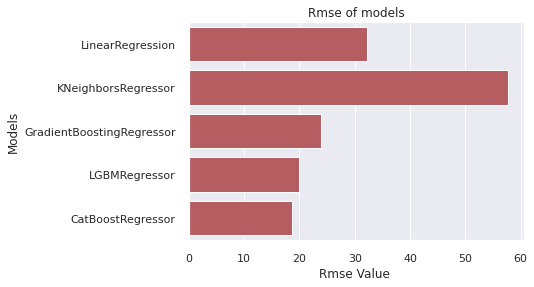

In [ ]:
result = []

results = pd.DataFrame(columns= ["Models","Rmse"])

for model in models:
    name = model.__class__.__name__
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    result = pd.DataFrame([[name, rmse]], columns= ["Models","Rmse"])
    results = results.append(result)


sns.barplot(x= 'Rmse', y = 'Models', data=results, color="r")
plt.xlabel('Rmse Value ')
plt.title('Rmse of models');

## 4.2. R^2 Score Comparison

In [ ]:
models = [
    lr_model,
    knn_model_tuned,
    gbm_tuned,
    lgbm_tuned,
    catb_tuned,

]


for model in models:
    name = model.__class__.__name__
    r2 = model.score(X_test, y_test)
    print("-"*28)
    print(name + ":" )
    print("R^2 Score: {:.4%}".format(r2))

----------------------------
LinearRegression:
R^2 Score: 97.4982%
----------------------------
KNeighborsRegressor:
R^2 Score: 91.9595%
----------------------------
GradientBoostingRegressor:
R^2 Score: 98.6163%
----------------------------
LGBMRegressor:
R^2 Score: 99.0418%
----------------------------
CatBoostRegressor:
R^2 Score: 99.1526%


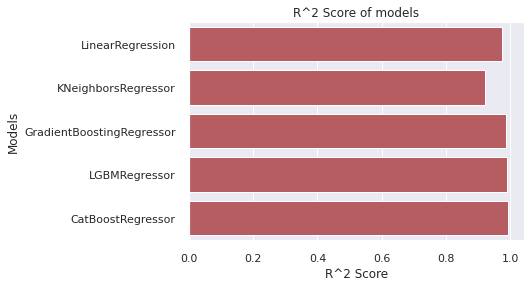

In [ ]:
result = []

results = pd.DataFrame(columns= ["Models","R^2 Score"])

for model in models:
    name = model.__class__.__name__
    r2 = model.score(X_test, y_test)
    result = pd.DataFrame([[name, r2]], columns= ["Models","R^2 Score"])
    results = results.append(result)


sns.barplot(x= 'R^2 Score', y = 'Models', data=results, color="r")
plt.xlabel('R^2 Score')
plt.title('R^2 Score of models');

* Best result is CatBoost model.